In [1]:
import json
import os
from pymongo import MongoClient
from mmdet.apis import init_detector, inference_detector
from mmdet.utils import register_all_modules
from mmdet.registry import VISUALIZERS
import mmcv
import gridfs
from PIL import Image, UnidentifiedImageError
import io
from tqdm import tqdm
import threading
import queue
from concurrent.futures import ThreadPoolExecutor
import time
import requests
import cv2
import numpy as np
from matplotlib import pyplot as plt

classes = ['ABZ533', 'ABZ61', 'ABZ308', 'ABZ342', 'ABZ55', 'ABZ384', 'ABZ68', 'ABZ15', 'ABZ335', 'ABZ579', 'ABZ331e+152i', 'ABZ139', 'ABZ401', 'ABZ142', 'ABZ86', 'ABZ537', 'ABZ111', 'ABZ457', 'ABZ99', 'ABZ461', 'ABZ80', 'ABZ70', 'ABZ381', 'ABZ306', 'ABZ371', 'ABZ449', 'ABZ366', 'ABZ318', 'ABZ112', 'ABZ5', 'ABZ85', 'ABZ440', 'ABZ427', 'ABZ396', 'ABZ354', 'ABZ104', 'ABZ231', 'ABZ545', 'ABZ75', 'ABZ214', 'ABZ13', 'ABZ589', 'ABZ328', 'ABZ343', 'ABZ367', 'ABZ232', 'ABZ191', 'ABZ62', 'ABZ1', 'ABZ142a', 'ABZ411', 'ABZ151', 'ABZ554', 'ABZ147', 'ABZ319', 'ABZ206', 'NoABZ0', 'ABZ73', 'ABZ480', 'ABZ97', 'ABZ597', 'ABZ312', 'ABZ465', 'ABZ334', 'ABZ470', 'ABZ532', 'ABZ212', 'ABZ536', 'ABZ52', 'ABZ12', 'ABZ330', 'ABZ84', 'ABZ69', 'ABZ72', 'ABZ331', 'ABZ437', 'ABZ230', 'ABZ397', 'ABZ279', 'ABZ6', 'ABZ60', 'ABZ74', 'ABZ144', 'ABZ383', 'ABZ296', 'ABZ211', 'ABZ441', 'ABZ58', 'ABZ128', 'ABZ570', 'ABZ586', 'ABZ207', 'ABZ324', 'ABZ455', 'ABZ376', 'ABZ78', 'ABZ471', 'ABZ535', 'ABZ295', 'ABZ59', 'ABZ314', 'ABZ145', 'ABZ353', 'ABZ412', 'ABZ575', 'ABZ115', 'ABZ7', 'ABZ38', 'ABZ472', 'ABZ101', 'ABZ167', 'ABZ322', 'ABZ172', 'ABZ79', 'ABZ468', 'ABZ595', 'ABZ399', 'ABZ313', 'ABZ529', 'ABZ143', 'ABZ148', 'ABZ339', 'ABZ134', 'ABZ2', 'ABZ538', 'ABZ393', 'ABZ298', 'ABZ50', 'ABZ483', 'ABZ559', 'ABZ87', 'ABZ94', 'ABZ152', 'ABZ138', 'ABZ164', 'ABZ565', 'ABZ205', 'ABZ598a', 'ABZ307', 'ABZ9', 'ABZ398', 'ABZ126', 'ABZ124', 'ABZ195', 'ABZ131', 'ABZ375', 'ABZ56', 'ABZ556', 'ABZ170']

In [2]:
class Fragment:
    def __init__(self, id="", filename=""):
        if filename != "":
            id = os.path.splitext(os.path.basename(filename))[0]
        self.id = id
        self.filename = filename

        self.bbox = None 
        self.label = None
        self.score = None
        self.signs_gt = ""
        self.orced_signs = ""
        self.image = None
    
    def set_detection(self, bbox, label, score):
        self.bbox = bbox
        self.label = label
        self.score = score

    def set_signs_gt(self, signs):
        self.signs_gt = signs

    def set_orced_signs(self, signs):
        self.orced_signs = signs

    def set_inference_result(self, result):
        self.result = result

    def visualize_with_result(self, visualizer):
        visualizer.add_datasample(
            'result',
            self.image,
            data_sample=self.result,
            draw_gt=False,
            wait_time=0,
        )
        visualizer.show()
        visualizer.fig_save
    
    def visualize_with_bbox(self, img):
        if self.bbox is not None:
            # Make a copy to avoid modifying original image
            img_draw = img.copy()
            # Draw each bbox (assume bbox format: [x1, y1, x2, y2])
            color = (0, 255, 0)  # green
            thickness = 2
            if isinstance(self.bbox, list):
                bboxes = self.bbox
            else:
                bboxes = self.bbox.tolist() if hasattr(self.bbox, 'tolist') else self.bbox
            for box in bboxes:
                x1, y1, x2, y2 = map(int, box)
                cv2.rectangle(img_draw, (x1, y1), (x2, y2), color, thickness)
            # Show image with matplotlib
            plt.figure(figsize=(10, 10))
            plt.imshow(img_draw)
            plt.axis('off')
            plt.show()

    # print fragment info
    def __repr__(self):
        return f"Fragment(id={self.id}, filename={self.filename}, bbox={self.bbox}, label={self.label}, score={self.score}, signs_gt={repr(self.signs_gt)})"

class EBLApiClient:
    BASE_URL = "https://ebl.badw.de/api/fragments/"

    def get_fragment_properties(self, fragment_id):
        url = f"{self.BASE_URL}{fragment_id}"
        response = requests.get(url)
        response.raise_for_status()
        return response.json()

    def get_signs(self, fragment_id):
        fragment = self.get_fragment_properties(fragment_id)
        return fragment.get("signs", [])
    
    def get_photo(self, fragment_id):
        url = f"{self.BASE_URL}{fragment_id}/photo"
        response = requests.get(url)
        response.raise_for_status()
        photo_data = response.content
        return photo_data

# Example usage of client:
client = EBLApiClient()
f = Fragment("BM.40757")
signs = client.get_signs(f.id)
photo_data = client.get_photo(f.id)
f.set_signs_gt(signs)
print(f)
with open("BM.40757_photo.jpg", "wb") as photo_file:
    photo_file.write(photo_data)
    


Fragment(id=BM.40757, filename=, bbox=None, label=None, score=None, signs_gt='X X X X X X X X X X X X X X\nX X X X X X X X X X X X X X X ABZ328 ABZ206 ABZ579 ABZ231 X ABZ597 ABZ13 ABZ97\nX X X X X X X X X X X X X ABZ144 ABZ296 ABZ427 ABZ318 ABZ437\nX X ABZ296 ABZ427 ABZ318 ABZ437 ABZ142 ABZ167 ABZ371 ABZ411 X X X ABZ151 ABZ9 ABZ381 ABZ537 ABZ69 ABZ342 ABZ330 ABZ122 |DU&DU|\nABZ1 X X ABZ296 ABZ69 ABZ586 ABZ170 ABZ342 ABZ307 ABZ166 ABZ318 ABZ322 ABZ330 ABZ74 ABZ74 ABZ533 ABZ545 ABZ13 ABZ314 ABZ13 ABZ103 ABZ465 ABZ367 NUN&NUN ABZ461\nX ABZ205 ABZ435 ABZ342 ABZ480 ABZ12 ABZ147 ABZ13 ABZ99 ABZ313 ABZ206 ABZ84 ABZ151 ABZ9 ABZ381 ABZ461 ABZ570 ABZ296 ABZ122 |DU&DU| ABZ461 ABZ570\nX ABZ330 ABZ74 ABZ74 ABZ461 ABZ570 ABZ13 ABZ411 ABZ111 ABZ205 ABZ435 ABZ342 ABZ1 ABZ470 ABZ13 ABZ103 ABZ465 ABZ367 NUN&NUN ABZ461 ABZ206 ABZ84\nX ABZ151 ABZ9 ABZ381 ABZ461 ABZ570 ABZ296 ABZ122 |DU&DU| ABZ461 ABZ570 ABZ330 ABZ74 ABZ74 ABZ533 ABZ461 ABZ570 ABZ13 ABZ70 ABZ70 ABZ458 ABZ206 ABZ342\nABZ1 ABZ470 ABZ13 ABZ97

In [3]:
# Read Photo File List
with open('eBL__photos.json', 'r') as f:
    photo_files = json.load(f)
elb_photo_fragments = []
for photo_file in photo_files:
    # Process each photo file
    fragment = Fragment(filename=photo_file['filename'])
    elb_photo_fragments.append(fragment)
print(f"Found {len(elb_photo_fragments)} photo names")

NUM_TO_PROCESS = 20

fragments_to_process = elb_photo_fragments[:NUM_TO_PROCESS]


# Read anotated fragments from JSON
import itertools


annotated_fragments = []
annotated_fragment_40757 = None
with open('../eBL_OCRed_Signs.json', 'r', encoding='utf-8') as f:
    # Use itertools.islice for efficient partial reading
    fs = json.load(f)
    print(f"Total annotated fragments in JSON: {len(fs)}")

    # search annotated fragments for "BM.40757"
    for item in fs:
        if item["filename"] == "BM.40757.jpg":
            annotated_fragment_40757 = Fragment(
                id=os.path.splitext(item["filename"])[0],
                filename=item["filename"]
            )
            annotated_fragment_40757.set_orced_signs(item["ocredSigns"])
            annotated_fragment_40757.set_detection(
                bbox=item.get("ocredSignsCoordinates", None),
                label=None,
                score=None
            )
            print(f"Found annotated fragment BM.40757: {annotated_fragment_40757}")
            break

    # get items 100 to 105
    data_iter = itertools.islice(fs, 100, 105)
    for item in data_iter:
        fragment = Fragment(
            id=os.path.splitext(item["filename"])[0],
            filename=item["filename"]
        )
        fragment.set_orced_signs(item["ocredSigns"])
        fragment.set_detection(
            bbox=item.get("ocredSignsCoordinates", None),
            label=None,
            score=None
        )
        annotated_fragments.append(fragment)
print(f"Loaded {len(annotated_fragments)} annotated fragments (100:105)")

for f in annotated_fragments:
    print(f.id, f.orced_signs, f.bbox)

Found 85338 photo names
Total annotated fragments in JSON: 72779
Found annotated fragment BM.40757: Fragment(id=BM.40757, filename=BM.40757.jpg, bbox=[[1084.5487060546875, 639.712890625, 1179.131591796875, 727.7496948242188], [1084.5487060546875, 639.712890625, 1179.131591796875, 727.7496948242188], [1639.673095703125, 627.6303100585938, 1736.4091796875, 726.2371826171875], [2033.160400390625, 714.713134765625, 2122.658935546875, 799.6776123046875], [1156.73779296875, 798.8997802734375, 1279.1324462890625, 892.1650390625], [1156.73779296875, 798.8997802734375, 1279.1324462890625, 892.1650390625], [923.36376953125, 954.4339599609375, 1033.008544921875, 1051.71533203125], [1043.507080078125, 879.6622924804688, 1149.6741943359375, 977.2722778320312], [1393.4873046875, 872.4163208007812, 1515.068359375, 975.206298828125], [1501.5592041015625, 954.0314331054688, 1573.452392578125, 1052.4342041015625], [1717.389404296875, 855.5360107421875, 1789.3519287109375, 968.0391845703125], [1769.75903

In [4]:
# Load model
config_file = 'checkpoint_config/detr.py'
checkpoint_file = 'checkpoint_config/epoch_50.pth'

model = init_detector(config_file, checkpoint_file, device='cuda:0')
register_all_modules()
visualizer = VISUALIZERS.build(model.cfg.visualizer)
visualizer.dataset_meta = model.dataset_meta

Loads checkpoint by local backend from path: checkpoint_config/epoch_50.pth


/home/jebediahc/anaconda3/envs/cuneiform-ocr/lib/python3.10/site-packages/mmengine/visualization/visualizer.py:196: UserWarning: Failed to add <class 'mmengine.visualization.vis_backend.LocalVisBackend'>, please provide the `save_dir` argument.
  warnings.warn(f'Failed to add {vis_backend.__class__}, '


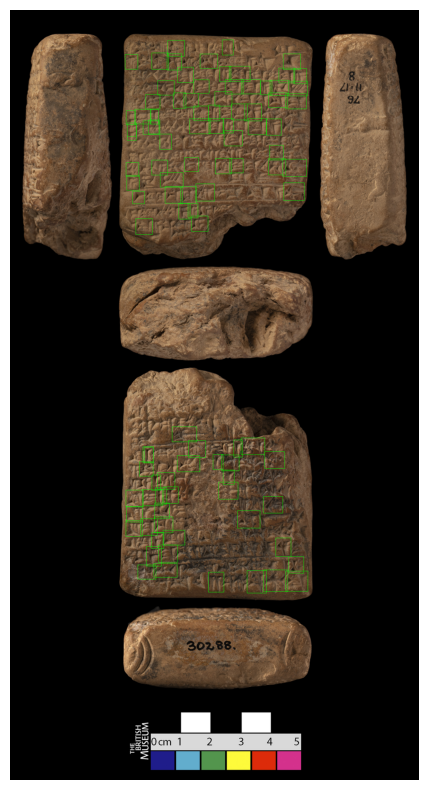

In [5]:
client = EBLApiClient()
img2 = client.get_photo(annotated_fragments[2].id)
img2_np = mmcv.imfrombytes(img2, channel_order='rgb')
annotated_fragments[2].visualize_with_bbox(img2_np)


Processed BM.40757:
ABZ554 
ABZ554 
ABZ554 
ABZ554 
ABZ554 
ABZ554 ABZ99 ABZ554 ABZ554 ABZ554 
ABZ554 ABZ554 ABZ554 ABZ62 ABZ532 ABZ554 ABZ80 ABZ579 ABZ554 ABZ554 ABZ554 ABZ554 
ABZ554 ABZ536 ABZ536 ABZ536 ABZ554 ABZ319 X ABZ342 ABZ554 ABZ554 ABZ191 
ABZ554 ABZ342 ABZ554 
ABZ554 ABZ554 ABZ536 ABZ536 ABZ401 ABZ554 
ABZ554 X 
ABZ554 ABZ554 ABZ80 ABZ554 
ABZ554 ABZ554 ABZ554 ABZ230 ABZ554 
ABZ554 ABZ554 
ABZ554 ABZ554 
ABZ554 ABZ554 
ABZ554 
ABZ554 
ABZ554 ABZ231 ABZ554 
ABZ554 ABZ554 ABZ554 X ABZ533 ABZ554 ABZ554 ABZ554 ABZ401 ABZ554 ABZ554 ABZ231 ABZ319 ABZ554 ABZ214 ABZ554 ABZ536 ABZ554 ABZ554 ABZ401 ABZ401 
ABZ554 
ABZ579 ABZ554 ABZ533 ABZ554 ABZ554 
ABZ465 
ABZ151 ABZ80 ABZ151 ABZ80 ABZ75 ABZ342 
ABZ342 ABZ230


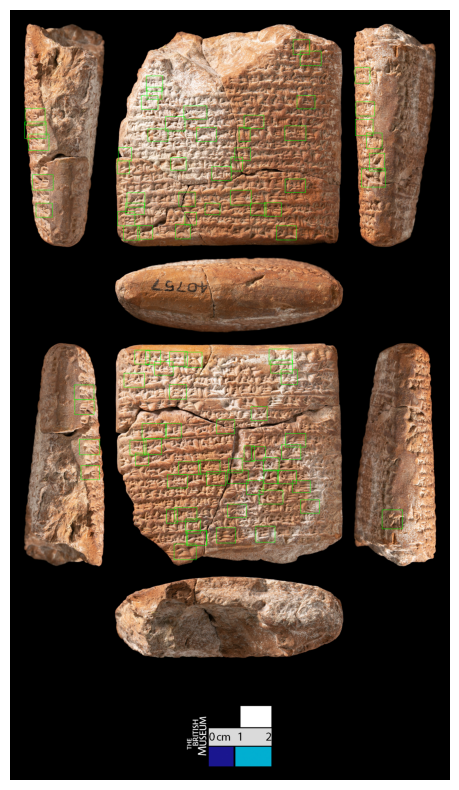

Annotated fragment 40757:
ABZ533 ABZ13 ABZ104 
ABZ13 
ABZ80 ABZ85 
ABZ318 ABZ330 ABZ70 ABZ597 ABZ579 ABZ70 ABZ597 ABZ142 ABZ461 
ABZ342 ABZ13 ABZ13 ABZ342 
ABZ70 ABZ396 ABZ579 
ABZ330 ABZ318 ABZ533 ABZ449 ABZ142 ABZ139 ABZ295 ABZ128 
ABZ412 ABZ449 ABZ449 ABZ142 ABZ70 ABZ142 
ABZ142 ABZ570 ABZ151 
ABZ128 ABZ296 ABZ13 
ABZ13 ABZ579 
ABZ579 ABZ330 ABZ142 ABZ55 ABZ399 ABZ313 ABZ579 ABZ533 
ABZ313 ABZ330 
ABZ366 
ABZ330 ABZ461 ABZ335 
ABZ308 ABZ74 ABZ533 ABZ86 ABZ461 ABZ318 ABZ318 ABZ575 ABZ480 ABZ13 
ABZ455 ABZ1 ABZ597 ABZ449 ABZ412 
ABZ449 ABZ206 
ABZ579 ABZ13 ABZ579 
ABZ308 ABZ366 ABZ536 ABZ461 
ABZ295 

 


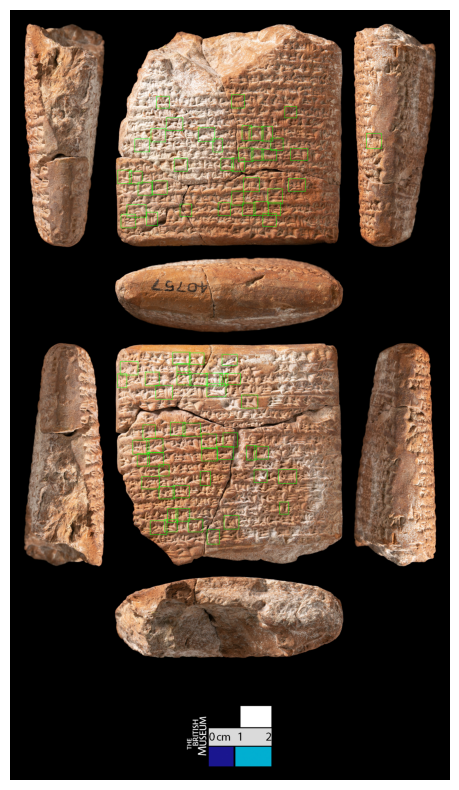

GT sign:
X X X X X X X X X X X X X X
X X X X X X X X X X X X X X X ABZ328 ABZ206 ABZ579 ABZ231 X ABZ597 ABZ13 ABZ97
X X X X X X X X X X X X X ABZ144 ABZ296 ABZ427 ABZ318 ABZ437
X X ABZ296 ABZ427 ABZ318 ABZ437 ABZ142 ABZ167 ABZ371 ABZ411 X X X ABZ151 ABZ9 ABZ381 ABZ537 ABZ69 ABZ342 ABZ330 ABZ122 |DU&DU|
ABZ1 X X ABZ296 ABZ69 ABZ586 ABZ170 ABZ342 ABZ307 ABZ166 ABZ318 ABZ322 ABZ330 ABZ74 ABZ74 ABZ533 ABZ545 ABZ13 ABZ314 ABZ13 ABZ103 ABZ465 ABZ367 NUN&NUN ABZ461
X ABZ205 ABZ435 ABZ342 ABZ480 ABZ12 ABZ147 ABZ13 ABZ99 ABZ313 ABZ206 ABZ84 ABZ151 ABZ9 ABZ381 ABZ461 ABZ570 ABZ296 ABZ122 |DU&DU| ABZ461 ABZ570
X ABZ330 ABZ74 ABZ74 ABZ461 ABZ570 ABZ13 ABZ411 ABZ111 ABZ205 ABZ435 ABZ342 ABZ1 ABZ470 ABZ13 ABZ103 ABZ465 ABZ367 NUN&NUN ABZ461 ABZ206 ABZ84
X ABZ151 ABZ9 ABZ381 ABZ461 ABZ570 ABZ296 ABZ122 |DU&DU| ABZ461 ABZ570 ABZ330 ABZ74 ABZ74 ABZ533 ABZ461 ABZ570 ABZ13 ABZ70 ABZ70 ABZ458 ABZ206 ABZ342
ABZ1 ABZ470 ABZ13 ABZ97 ABZ206 ABZ84 ABZ151 ABZ9 ABZ381 ABZ461 ABZ570 ABZ296 ABZ122 |DU&DU| ABZ461 A

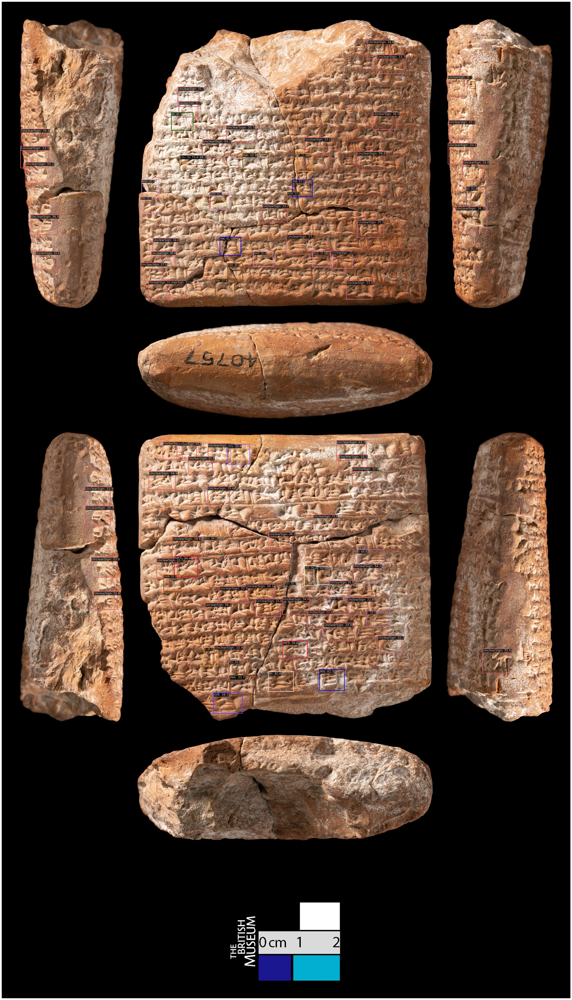

In [8]:
def download_fragment_data(fragment: Fragment, client):
    fragment_id = fragment.id
    try:
        signs = client.get_signs(fragment_id)
        photo_data = client.get_photo(fragment_id)
        fragment.set_signs_gt(signs)
        fragment.image = mmcv.imfrombytes(photo_data, channel_order='rgb')
        return fragment
    except Exception as e:
        print(f"Error downloading fragment {fragment_id}: {e}")
        return None

def process_fragment_data(fragment: Fragment, model, classes):
    try:
        # Process image
        img = fragment.image
        result = inference_detector(model, img)
        fragment.set_inference_result(result)

        OCR_result = result.pred_instances.cpu()
        labels, bboxes = OCR_result['labels'], OCR_result['bboxes']
        THRESHOLD_CERTAIN = 0.1
        certain_scores_idx = len(OCR_result['scores'][OCR_result['scores'] > THRESHOLD_CERTAIN])
        certain_bboxes = bboxes[:certain_scores_idx]
        labels = OCR_result['labels'][:certain_scores_idx]

        # Sort and group bounding boxes into lines
        indexed_bounding_boxes = list(enumerate(certain_bboxes))
        sorted_indexed_bounding_boxes = sorted(indexed_bounding_boxes, key=lambda item: (item[1][1], item[1][0]))
        lines = []
        current_line = []
        y_threshold = 50
        for i, (index, box) in enumerate(sorted_indexed_bounding_boxes):
            if not current_line:
                current_line.append((index, box))
            else:
                prev_box = current_line[-1][1]
                if box[1] - prev_box[1] < y_threshold:
                    current_line.append((index, box))
                else:
                    lines.append(current_line)
                    current_line = [(index, box)]
        if current_line:
            lines.append(current_line)

        sorted_lines = [sorted(line, key=lambda item: item[1][0]) for line in lines]

        # Collect OCR results
        ocr_text = ""
        bounding_boxes = []
        for line in sorted_lines:
            for index, box in line:
                if classes[labels[index]] == 'NoABZ0':
                    ocr_text += 'X '
                else:
                    ocr_text += classes[labels[index]] + ' '
                bounding_boxes.append(box.tolist())
            ocr_text += '\n'

        filename = fragment.filename
        fragment.set_orced_signs(ocr_text.strip())
        fragment.set_detection(bbox=bounding_boxes, label=labels, score=None)
        return {
            "ocredSigns": ocr_text,
            "filename": filename,
            "ocredSignsCoordinates": bounding_boxes
        }
    
    except Exception as e:
        print(f"Error processing fragment {fragment.id}: {e}")
        return None


# test single fragments
filename = "BM.40757.jpg"
fragment = Fragment(filename=filename)
ok = download_fragment_data(fragment, client)
if ok:
    test_result = process_fragment_data(fragment, model, classes)
    print(f"Processed {fragment.id}:\n{fragment.orced_signs if test_result else 'Failed'}")
else:
    print(f"Failed to download {fragment.id}")



fragment.visualize_with_result(visualizer)
fragment.visualize_with_bbox(fragment.image)


print(f"Annotated fragment 40757:\n{annotated_fragment_40757.orced_signs}\n ")
annotated_fragment_40757.visualize_with_bbox(fragment.image)

print(f"GT sign:\n{fragment.signs_gt}\n ")

print("inference result:")
visualizer.show()
visualizer.fig_save

In [ ]:
# read existing output.json
with open('output.json', 'r+', encoding='utf-8') as f:
    output_data = json.load(f)

# queue and lock
download_queue = queue.Queue(maxsize=10)  # limit queue size to avoid excessive memory usage
result_lock = threading.Lock()
download_complete = threading.Event()
visualization_count = 0
MAX_VISUALIZATIONS = 5  # keep only the latest 5 visualizations

# statistics
downloaded_count = 0
processed_count = 0
failed_count = 0
total_fragments = len(fragments_to_process)

def clean_old_visualizations():
    import glob
    files = glob.glob('visualization_*.png')
    if len(files) > MAX_VISUALIZATIONS:
        # delete the oldest
        files.sort(key=os.path.getmtime)
        for old_file in files[:-MAX_VISUALIZATIONS]:
            try:
                os.remove(old_file)
            except:
                pass

def download_worker():
    global downloaded_count
    for fragment in fragments_to_process:
        ok = download_fragment_data(fragment, client)
        if ok:
            download_queue.put(fragment)
            downloaded_count += 1
        else:
            # put and None when fail to keep counting correctly
            download_queue.put(None)
    
    # send ending signal
    download_complete.set()

def process_worker():
    global processed_count, failed_count, visualization_count
    
    while True:
        try:
            # wait for data from the queue, set timeout to avoid blocking indefinitely
            fragment = download_queue.get(timeout=5)

            if fragment is None:
                # skip failed downloads
                failed_count += 1
            else:

                # process data
                result = process_fragment_data(fragment, model, classes)
                if result:
                    with result_lock:
                        output_data.append(result)
                    processed_count += 1
                else:
                    failed_count += 1
        

            download_queue.task_done()
            
        except queue.Empty:
            # if download complete and queue is empty
            if download_complete.is_set() and download_queue.empty():
                break
        except Exception as e:
            print(f"Error in process worker: {e}")

print(f"Start processing {total_fragments} fragments...")
print("Download threads(1) + inference threads(2)")
print(f"Save the first {MAX_VISUALIZATIONS} visualizations")

# clean up old visualizations
clean_old_visualizations()

# start threads
download_thread = threading.Thread(target=download_worker)
process_threads = []
num_process_workers = 2

download_thread.start()

for i in range(num_process_workers):
    thread = threading.Thread(target=process_worker)
    thread.start()
    process_threads.append(thread)

# progress monitoring
initial_output_count = len(output_data)
with tqdm(total=total_fragments, desc="Processing") as pbar:
    while download_thread.is_alive() or not download_queue.empty() or any(t.is_alive() for t in process_threads):
        current_progress = processed_count + failed_count
        pbar.n = current_progress
        pbar.set_postfix({
            'Downloaded': downloaded_count, 
            'Processed': processed_count, 
            'Failed': failed_count,
            'Visualized': min(visualization_count, MAX_VISUALIZATIONS)
        })
        pbar.refresh()
        time.sleep(0.5)
    
    # final update
    pbar.n = total_fragments
    pbar.set_postfix({
        'Downloaded': downloaded_count, 
        'Processed': processed_count, 
        'Failed': failed_count,
        'Visualized': min(visualization_count, MAX_VISUALIZATIONS)
    })
    pbar.refresh()

# wait for all threads to complete
download_thread.join()
for thread in process_threads:
    thread.join()

print(f"Processing complete!")
print(f"Total: {total_fragments}, Success: {processed_count}, Failed: {failed_count}")
print(f"Visualized files saved: {min(visualization_count, MAX_VISUALIZATIONS)}")


# Save results
with open('output.json', 'w', encoding='utf-8') as f:
    json.dump(output_data, f, ensure_ascii=False, indent=4)

print(f"Results saved to output.json, {len(output_data) - initial_output_count} new records added")
print(f"Visualized files saved as: visualization_*.png")

Start processing 20 fragments...
Download threads(1) + inference threads(2)
Save the first 5 visualizations


Processing: 100%|██████████| 20/20 [00:37<00:00,  1.88s/it, Downloaded=20, Processed=20, Failed=0, Visualized=0]

Processing complete!
Total: 20, Success: 20, Failed: 0
Visualized files saved: 0
Results saved to output.json, 20 new records added
Visualized files saved as: visualization_*.png


: 